<a href="https://colab.research.google.com/github/AndreaMagnanini/AI-School/blob/main/ShapleyValues.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

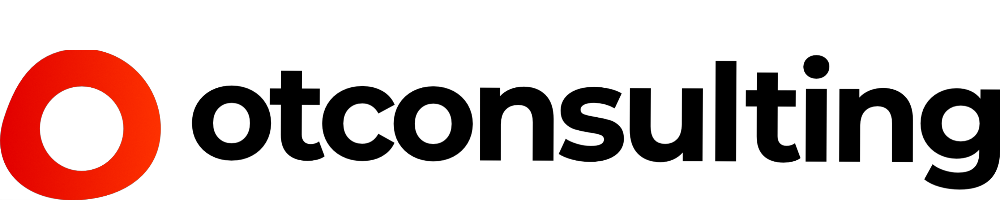

________________________________________________________________________________________________________________________________________________________________
\begin{align}
  \text{}
\end{align}
\begin{align}
  \text{Progetto di}
\end{align}
\begin{align}
  \text{}
\end{align}
\begin{align}
  \huge \text{ Scaltriti Federico}
\end{align}
\begin{align}
  \text{}
\end{align}
\begin{align}
  \huge \text{ Magnanini Andrea}
\end{align}
\begin{align}
  \text{}
\end{align}
\begin{align}
 \text{per il Corso di Perfezionamento}
\end{align}
\begin{align}
  \text{}
\end{align}
<center>
<a href="https://aischools.it/"><img src="https://aischools.it/wp-content/uploads/2021/08/ai-logo.svg" width=400 /></a>
</center>
________________________________________________________________________________________________________________________________________________________________

<div id="header" width=100%>
<table class="tfo-notebook-buttons" align="left" >
  <td>
    <a href="https://keras.io/"><img src="https://keras.io/img/logo.png" width="2050" >
      </a>
  </td>
  <td>
  <a href="https://www.tensorflow.org/"><img src="https://www.gstatic.com/devrel-devsite/prod/v24d520161c9661e427a3f6fa9973bfca56d0972dca82fa8ef65c709d915e80f3/tensorflow/images/lockup.svg"  width=2750 /></a>
  </td>
  <td>
     <a href="https://numpy.org/" ><img src="https://upload.wikimedia.org/wikipedia/commons/thumb/3/31/NumPy_logo_2020.svg/2560px-NumPy_logo_2020.svg.png" width=1700 /></a>
  </td> 
  <td>
    <a href="https://pandas.pydata.org/"><img src="https://upload.wikimedia.org/wikipedia/commons/thumb/e/ed/Pandas_logo.svg/2560px-Pandas_logo.svg.png" /></a>
  </td>
  <td>
    <a href="https://matplotlib.org/stable/index.html#"><img src="https://matplotlib.org/stable/_images/sphx_glr_logos2_003.png" width=2400 />
      </a>
  </td>
</table>
</div>


# <h1><center>Additive Shapley Values</center></h1>

Rientra nell'insieme di tecniche di Feature Relevance Explanation. La rilevanza assegnata ad ogni feature è costituita da un punteggio ottenuto come prodotto della **Teoria dei Giochi**, in cui si assume ogni feature sia coinvolta in un gioco collaborativo finalizzato a massimizzare la likelyhood. I valori assegnati sono detti Valori di Shapley, ed indicano *quanto* la feature, all'interno del gioco, ha contribuit alla *vittoria* della propria *coalizione*. \\
E' possibile visionare un elaborato, da noi prodotto, che sintetizza la teoria su cui Shap si basa al seguente <a href="https://drive.google.com/file/d/1t3_IjN76LU9BUR8vakkyBGjSW0etl_JN/view?usp=share_link">link</a>.

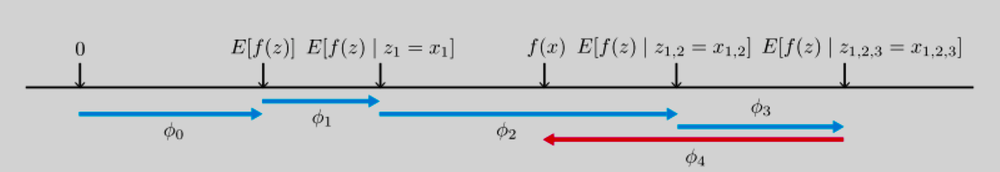

Assegna per ogni feature un valore di importanza per ogni predizione, attraverso l'individuazione di un'unica funzione che è soluzione del problema analizzato. \\
I valori di SHAP spiegano come passare dal valore di base $E[f(z)]$ (cioè il valore predetto se non fosse nota alcuna feature) al valore di output attuale $f(x)$. Il diagramma che segue illustra un ordinamento singolo. Al fine dell'ottenimento del valore previsto, quando il modello non è lineare o le input feature non sono indipendenti, è importante anche l'ordine in cui sono considerate per. In quel caso i valori di
SHAP si ottengono calcolando la media tra i valori $\phi_i$ in tutti i possibili ordini.

Il calcolo dei valori di SHAP non è semplice ma può essere approssimato per ottenere dei valori ad alta fedeltà come descritto da Lundberg e Lee nel <a href="https://proceedings.neurips.cc/paper/2017/file/8a20a8621978632d76c43dfd28b67767-Paper.pdf">paper di riferimento</a>.


# $\text{Startup}$

## <h3>Install SHAP package </h3>

In [ ]:
import sys
!{sys.executable} -m pip install shap

## <h3>Imports</h3>

In [2]:
import tensorflow as tf
import keras
import pandas as pd
import numpy as np
import nltk
import os
import json
import re
import pickle

from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from nltk.corpus import stopwords
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

## <h3>Model Loading</h3>

In [3]:
model_path = tf.keras.utils.get_file("model.h5", "https://github.com/AndreaMagnanini/AI-School/blob/main/Model.h5?raw=true")
model = tf.keras.models.load_model(model_path)
print(model.summary())
print(model)

2348760/2348760 [==============================] - 0s 0us/step
Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_9 (Embedding)     (None, 100, 64)           512064    
                                                                 
 dropout_27 (Dropout)        (None, 100, 64)           0         
                                                                 
 global_max_pooling1d_9 (Glo  (None, 64)               0         
 balMaxPooling1D)                                                
                                                                 
 dropout_28 (Dropout)        (None, 64)                0         
                                                                 
 dense_27 (Dense)            (None, 528)               34320     
                                                                 
 dropout_29 (Dropout)        (None, 528)               0 

## <h3> Dataset Loading </h3>

In [4]:
df_reduced = pd.read_csv("https://raw.githubusercontent.com/AndreaMagnanini/AI-School/main/df_reduced.csv")
STOPWORDS = set(stopwords.words('italian'))

In [ ]:
REPLACE_BY_SPACE_RE = re.compile('[/(){}\[\]\|@,;]')
BAD_SYMBOLS_RE = re.compile('[^0-9a-z #+_]')
STOPWORDS = set(stopwords.words('italian') + ['and', 'buongiorno', 'buonasera', 
                                              'buonpomeriggio', 'buon pomeriggio', 
                                              'buona sera', 'buon giorno', 
                                              'resi e rimborsi', 'ordini e spedizioni',
                                              'salve'])

def clean_text(text):
    """
        text: a string
        return: modified initial string
    """
    text = str(text).lower()
    text = REPLACE_BY_SPACE_RE.sub(' ', text)
    text = BAD_SYMBOLS_RE.sub('', text)

    text = ' '.join(word for word in text.split() if word not in STOPWORDS) # remove stopwors from text
    return text

In [14]:
X = df_reduced["Text"]
X = X.apply(clean_text)
X = X.str.replace('\d+', '')

## <h3>Tokenizer Loading</h3>

In [5]:
import urllib.request
with urllib.request.urlopen("https://github.com/AndreaMagnanini/AI-School/blob/main/tokenizer_subtype_alm_bal_2.pickle?raw=true") as handle:
  tokenizer = pickle.load(handle)

word_index = tokenizer.word_index
print('Found %s unique tokens.' % len(word_index))

Found 19708 unique tokens.


## <h3>Utils</h3>

In [6]:
# The maximum number of words to be used. (most frequent)
MAX_NB_WORDS = 8000
# Max number of words in each complaint.
MAX_SEQUENCE_LENGTH = 100
# This is fixed.
EMBEDDING_DIM = 64

In [8]:
classes = np.unique(df_reduced["Subtype"])
classes[np.where(classes == "FC Other")[0]] = "Fidelity Card"
classes

array(['Change / cancel order', 'Delivery errors', 'Fidelity Card',
       'Failed pick-up', 'Fit and measurements', 'Order information',
       'Other', 'Payment problems', 'Products availability',
       'Products info', 'Return instructions and timings',
       'Return procedure authorization', 'Shipment progress',
       'Undeliverable order'], dtype=object)

# $\text{Shapley Values Implementation with SHAP}$

<center>
<a href="https://github.com/slundberg/shap"><img src="https://raw.githubusercontent.com/slundberg/shap/master/docs/artwork/shap_header.svg"/></a>
</center>

In [9]:
import shap

def f(x):
    x_token = tokenizer.texts_to_sequences(np.asarray(x))
    text_data = pad_sequences(x_token, maxlen=MAX_SEQUENCE_LENGTH)
    return model.predict(text_data)

In [10]:
masker=shap.maskers.Text(tokenizer=r"\W+")

In [11]:
def get_subtype(str):
    if str in X.unique():
        index = X[X==str].index[0]
        row = df_reduced.loc[[index]]
        subtype = row["Subtype"].values
        return subtype[0], index
    else:
        return 'NOT FOUND', -1

In [63]:
def shap_explaination(index):
    example = samples[index]
    subtype, idx = get_subtype(example)
    if (subtype == 'FC Other'):
      subtype = "Fidelity Card"
    print("Making SHAP Explaination for the given sample, [true class: "+subtype+"]:")
    if(len(example) < 202):
      print("< "+example+" > ")
    print("\n")

    shap.plots.text(shaps[index])


In [12]:
explainer = shap.Explainer(f, masker=masker, output_names=classes)

# $\text{Explainations}$
<h5> Three prediction examples are given to evaluate the implemented explaination. The results of these explainations are discussed in the document attached to the project delivery. </h5>

In [36]:
# collect the three established examples from the dataset
samples = np.array([X.values[16941], X.values[17017], X.values[16919]])
samples = pd.Series(samples)
samples

0    Fidelity Card Buongiorno, ho appena effettuato...
1    Disponibilità e informazioni sul prodotto Buon...
2    I: R: [Ticket-CSD#2021012699016405] Richiesta ...
dtype: object

In [ ]:
import datetime

# measure elapsed time
start = datetime.datetime.now()
shaps = explainer(samples)
elapsed = datetime.datetime.now() - start

In [41]:
print(f'Fitting explainer on three samples took (hh:mm:ss.ms) {elapsed}')

Fitting explainer on three samples took (hh:mm:ss.ms) 0:00:14.056332


In [65]:
# initialize node.js to plot dynamic graphics
shap.initjs()

<h4>The structure returned by the explainer fitted on the samples, is composed by a row for every passed sample. Each row is composed by three different arrays as columns:</h4>
<ul>
<li><h4> array of the single words, compising the features;</h4></li>
<li><h4> array of the base values, one for each predictable final class. These are the average probabilities of the classes made on the given samples;</h4></li>
<li><h4> array of the Shapley Values. In this case there are 14 Shapley Values associated to each word, representing how much that word contributed to every class.</h4></li>

In [98]:
shaps.base_values[0]

array([2.88071600e-03, 4.61232245e-01, 7.84053991e-04, 2.38353969e-03,
       2.47926451e-03, 4.44096234e-03, 1.02578953e-01, 1.58642739e-04,
       5.81206242e-03, 2.64002173e-03, 6.17828555e-02, 3.17908734e-01,
       3.47603969e-02, 1.57555201e-04])

In [102]:
shaps.values[0].shape

(51, 14)

In [100]:
shaps.data[0]

array(['Fidelity ', 'Card ', 'Buongiorno, ', 'ho ', 'appena ',
       'effettuato ', 'un ', 'acquisto ', 'online ', 'che ', 'mi ',
       'darebbe ', 'la ', 'possibilità ', 'di ', 'accedere ', 'ad ',
       'un ', 'buono ', 'sconto ', 'del ', 'valore ', 'di ', '25?, ',
       'vi ', 'scrivo ', 'per ', 'poter ', 'riuscire ', 'ad ', 'avere ',
       'i ', 'pinti ', 'caricati ', 'sulla ', 'tessera ', 'qualche ',
       'giorno ', 'prima ', 'del ', '28/', '02, ', 'giorno ', 'in ',
       'cui ', 'mi ', 'sembra ', 'di ', 'capire ', 'che ', 'scadranno'],
      dtype=object)

In [103]:
shaps.data[0].shape

(51,)

# $\text{Example: correct prediction}$

In [66]:
shap_explaination(0)

Making SHAP Explaination for the given sample, [true class: Fidelity Card]:




# $\text{Example: correct prediction, wrong decisions}$

In [67]:
shap_explaination(1)

Making SHAP Explaination for the given sample, [true class: Fit and measurements]:
< Disponibilità e informazioni sul prodotto Buonasera, Qual è la lunghezza della cintura in cm per la taglia L e XL?  > 




# $\text{Example: wrong prediction}$

In [68]:
shap_explaination(2)

Making SHAP Explaination for the given sample, [true class: Undeliverable order]:


